In [16]:
import numpy as np
import matplotlib.pyplot as plt
import time
import os

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.autograd as autograd
from PIL import Image
import torchvision.models as models

import torchvision
from torchvision import datasets, transforms
import torchvision.utils as vutils
import torch.utils.data as data
from torch.utils.data import Dataset, DataLoader,random_split, RandomSampler

if torch.cuda.is_available():
    device = torch.device('cuda')
    dtype = torch.cuda.FloatTensor
else:
    device = torch.device('cpu')
    dtype = torch.FloatTensor


from mmd import _mix_rq_kernel, _mix_rbf_kernel, _distance_kernel, mmd2, gradient_penalty
from architecture import Generator_CelebA, Discriminator_CelebA
from utils import show, weights_init, imshow
print(device)

cuda


In [17]:
def show_dataset(images, batch_size=128):
    pil_img = imshow(torchvision.utils.make_grid(images[:batch_size].to('cpu'),nrow=16))
    return(pil_img)

In [18]:
class options:
    cuda = True
    batch_size = 128
    image_size = 64
    n_filters = 100

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
])

class CelebADataset_flat(Dataset):
    def __init__(self, root_dir, transform=transform):
        self.root_dir = root_dir
        self.transform = transform
        self.file_list = os.listdir(root_dir)

    def __len__(self):
        return len(self.file_list)

    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.file_list[idx])
        image = Image.open(img_name)

        if self.transform:
            image = self.transform(image)

        return image.flatten()

dataset_flat = CelebADataset_flat('./celebA/')
batch_size = 1000
data_loader = DataLoader(dataset_flat, batch_size=batch_size, shuffle=True)

In [19]:
class CelebADataset(Dataset):
    def __init__(self, root_dir, transform=transform):
        self.root_dir = root_dir
        self.transform = transform
        self.file_list = os.listdir(root_dir)

    def __len__(self):
        return len(self.file_list)

    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.file_list[idx])
        image = Image.open(img_name)

        if self.transform:
            image = self.transform(image)

        return image

dataset = CelebADataset('./celebA/')

split_sizes = [len(dataset) // 2, len(dataset) - (len(dataset) // 2)]

# Randomly split the dataset into two parts
train_dataset, test_dataset = random_split(dataset, split_sizes)

limit_train = 10000
sampler_train = RandomSampler(data_source=train_dataset, num_samples=limit_train)
train_loader = DataLoader(train_dataset, batch_size=batch_size, sampler=sampler_train)

limit_test = 3000
sampler_test = RandomSampler(data_source=test_dataset, num_samples=limit_test)
test_loader = DataLoader(test_dataset, batch_size=batch_size, sampler=sampler_test)

# # Create data loaders for each split
# train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
# test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

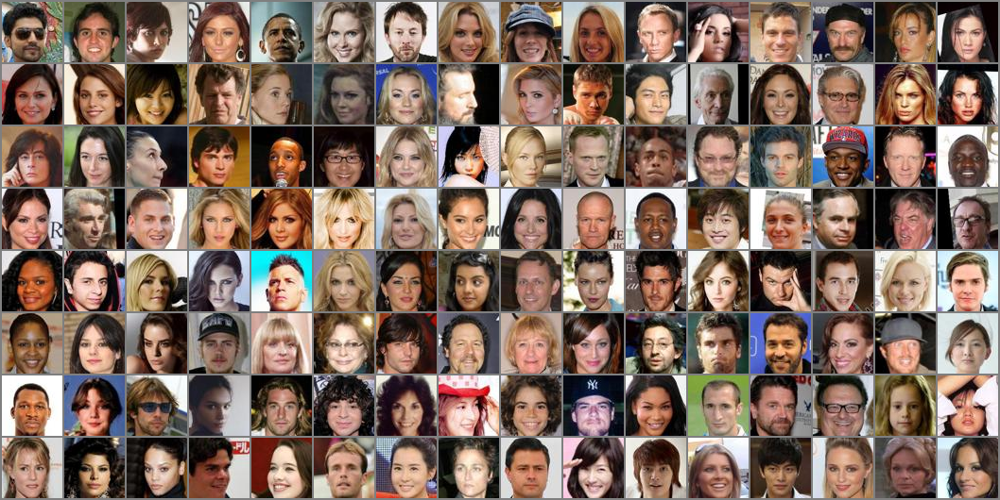

In [21]:
for y in train_loader:
    show_dataset(y, batch_size=128)
    break

## Without Discriminator

/users/eleves-a/2021/ahmad.rammal/miniconda3/envs/gm/lib/python3.9/site-packages/torch/nn/modules/conv.py:952: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv_transpose2d(


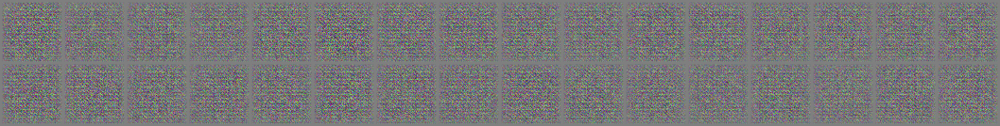

In [3]:
torch.manual_seed(1)

# Create the generator and discriminator
G = Generator_CelebA().to(device)

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.02.
G.apply(weights_init);

show(G);

In [4]:
lr = 0.001 
n_epochs = 5
batch_size=250
kernel = _distance_kernel
Glosses = []
epoch_display = 20

torch.manual_seed(1)  # initialize random seed for reproducibility

optimG = optim.Adam(G.parameters(), lr=lr)

[0/5] 	Loss_G: 28.9394
[0/5] 	Loss_G: 1.9628
[0/5] 	Loss_G: 0.7006
[0/5] 	Loss_G: 1.3932
[0/5] 	Loss_G: 0.4155
[0/5] 	Loss_G: 0.2570
[0/5] 	Loss_G: 0.4225
[0/5] 	Loss_G: 0.1123
[0/5] 	Loss_G: 0.1268
[0/5] 	Loss_G: 0.1274


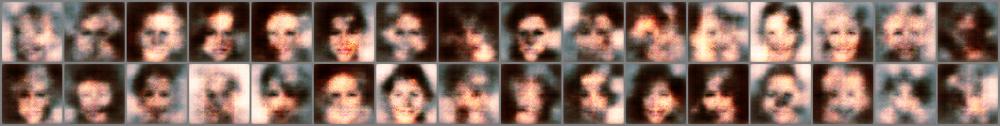

[1/5] 	Loss_G: 0.0064
[1/5] 	Loss_G: 0.0312
[1/5] 	Loss_G: 0.0353
[1/5] 	Loss_G: 0.0184
[1/5] 	Loss_G: 0.2379
[1/5] 	Loss_G: 0.1822
[1/5] 	Loss_G: -0.1037
[1/5] 	Loss_G: 0.0560
[1/5] 	Loss_G: 0.3851
[1/5] 	Loss_G: 0.3833


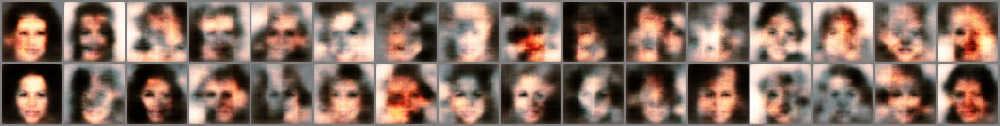

[2/5] 	Loss_G: -0.0205
[2/5] 	Loss_G: 0.0492
[2/5] 	Loss_G: 0.3515
[2/5] 	Loss_G: 0.1169
[2/5] 	Loss_G: -0.0933
[2/5] 	Loss_G: 0.0404
[2/5] 	Loss_G: 0.1076
[2/5] 	Loss_G: -0.0342
[2/5] 	Loss_G: 0.3313
[2/5] 	Loss_G: 0.0240


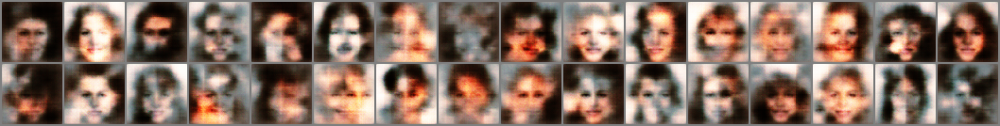

[3/5] 	Loss_G: 0.2197
[3/5] 	Loss_G: -0.0171
[3/5] 	Loss_G: 0.0533
[3/5] 	Loss_G: 0.0590
[3/5] 	Loss_G: 0.1099
[3/5] 	Loss_G: 0.0900
[3/5] 	Loss_G: 0.0192
[3/5] 	Loss_G: -0.0785
[3/5] 	Loss_G: 0.0202
[3/5] 	Loss_G: 0.4434


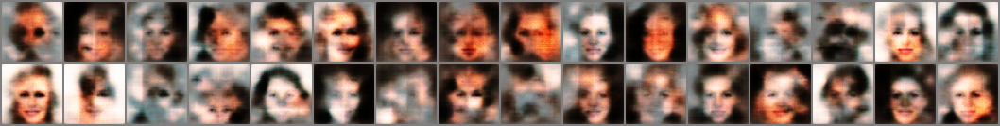

[4/5] 	Loss_G: -0.1344
[4/5] 	Loss_G: -0.0945
[4/5] 	Loss_G: 0.3895
[4/5] 	Loss_G: 0.2159
[4/5] 	Loss_G: 0.0224
[4/5] 	Loss_G: 0.2378
[4/5] 	Loss_G: 0.1404
[4/5] 	Loss_G: -0.0951
[4/5] 	Loss_G: 0.7287
[4/5] 	Loss_G: -0.0182


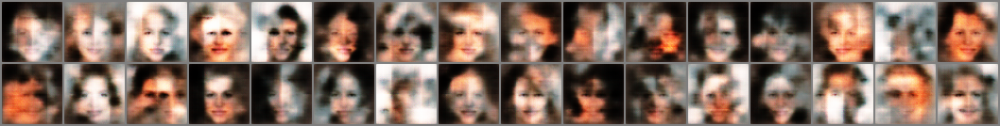

In [5]:
# Main loop
torch.manual_seed(1)
for epoch in range(n_epochs):
    
    Gloss = torch.tensor(0.0, device=device)
    counter = 0
    for y in data_loader:
        y = y.to(device)
        z = torch.randn(batch_size, options.n_filters, 1, 1).to(device)
        x = G(z).flatten().reshape(batch_size, -1)
        optimG.zero_grad()
        Gloss = mmd2(kernel, x, y)
        Gloss.backward()
        optimG.step()
        
        if counter%epoch_display == 0 :
            # Output training stats
            print('[%d/%d] \tLoss_G: %.4f'
              % (epoch, n_epochs, Gloss.item()))
            Glosses.append(Gloss.item())
            
        counter+=1
        
    show(G)

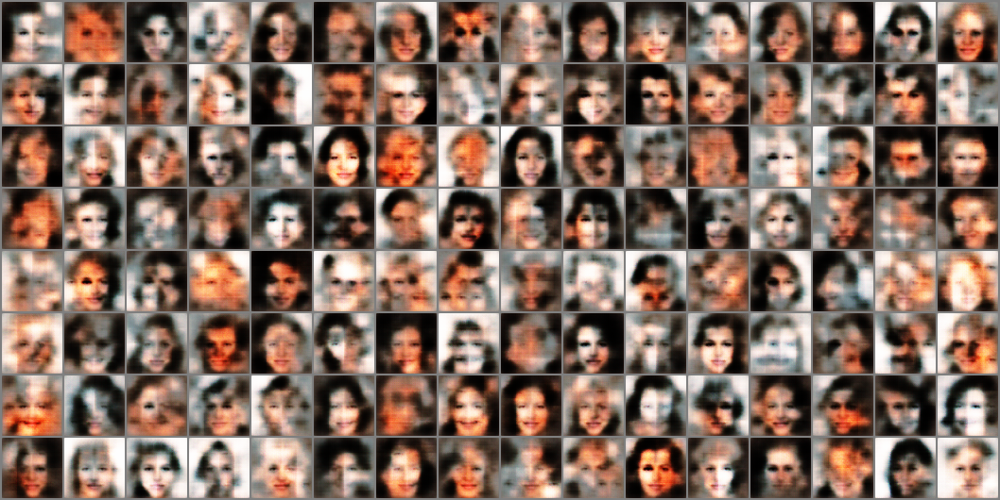

In [7]:
show(G, batch_size=128)

## With Discriminator

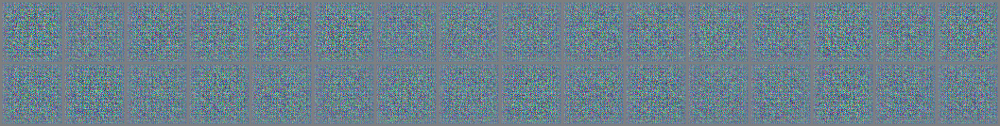

In [9]:
torch.manual_seed(1)

# Create the generator and discriminator
G = Generator_CelebA().to(device)
D = Discriminator_CelebA().to(device)

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.02.
G.apply(weights_init);
D.apply(weights_init);

show(G);

In [12]:
torch.manual_seed(1)

lr = 2e-4
kernel = _distance_kernel

## parameters for training
n_epochs = 50
niterD= 1
niterG= 1
b = 1000
gpw = 10

torch.manual_seed(1) 

optimD = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999)) #, weight_decay=1e-2)
optimG = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))

Glosses = []
Dlosses = []

# schedulerD = StepLR(optimD, step_size=30, gamma=0.5)
# schedulerG = StepLR(optimG, step_size=10, gamma=0.5)

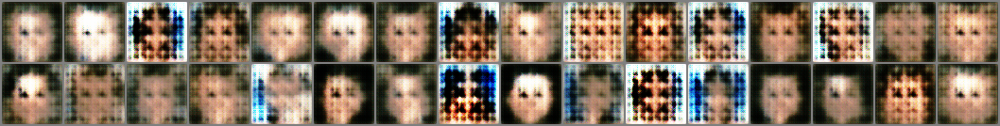

[0/50] 	Loss_D: 20458.3512	Loss_G: 23958.7461


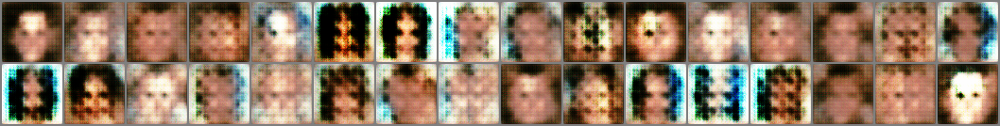

[1/50] 	Loss_D: 13191.5761	Loss_G: 20825.8799


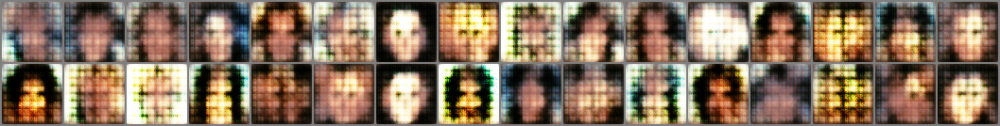

[2/50] 	Loss_D: 10950.2731	Loss_G: 23125.0423


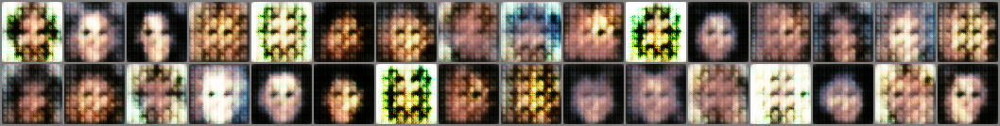

[3/50] 	Loss_D: 17753.4128	Loss_G: 25260.4206


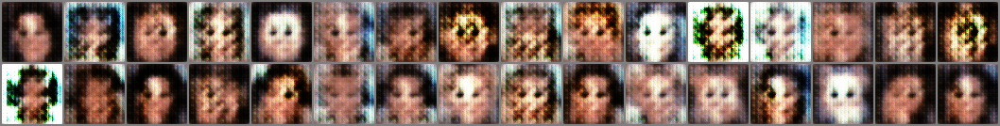

[4/50] 	Loss_D: 15964.3876	Loss_G: 27527.9095


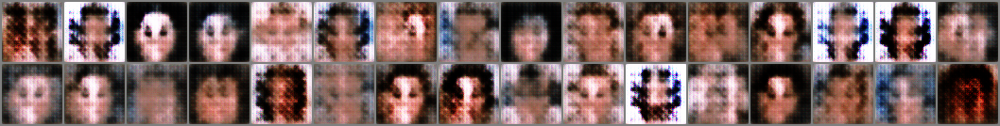

[5/50] 	Loss_D: 19576.2237	Loss_G: 26630.3047


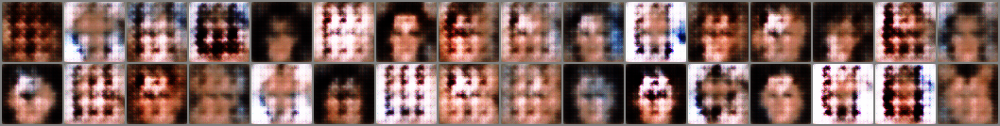

[6/50] 	Loss_D: 12729.9353	Loss_G: 29070.0579


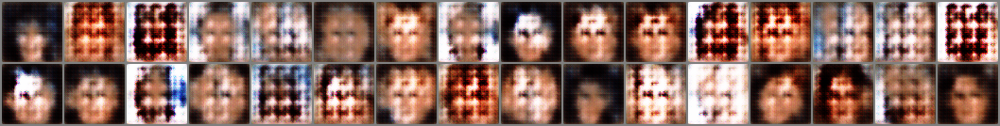

[7/50] 	Loss_D: 22096.6969	Loss_G: 25344.5169


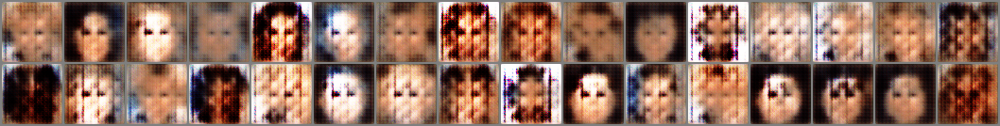

[8/50] 	Loss_D: 13637.2956	Loss_G: 26574.4661


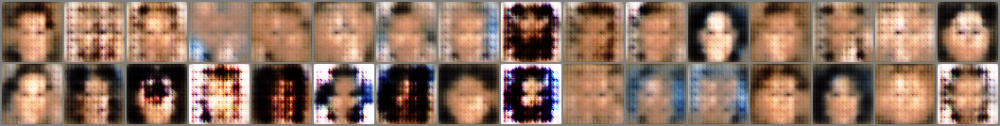

[9/50] 	Loss_D: 18074.8998	Loss_G: 22864.0049


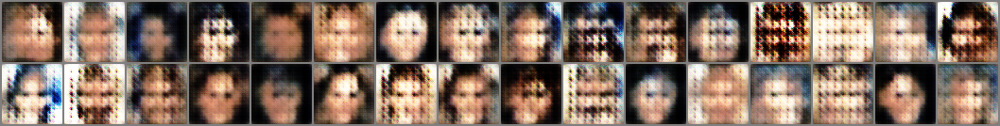

[10/50] 	Loss_D: 13692.0349	Loss_G: 23383.2083


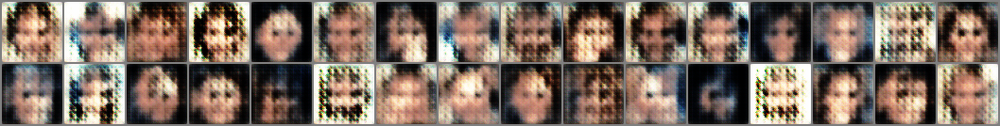

[11/50] 	Loss_D: 22069.7608	Loss_G: 29444.2669


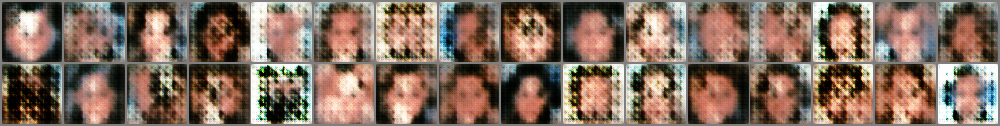

[12/50] 	Loss_D: 17824.7569	Loss_G: 30501.3984


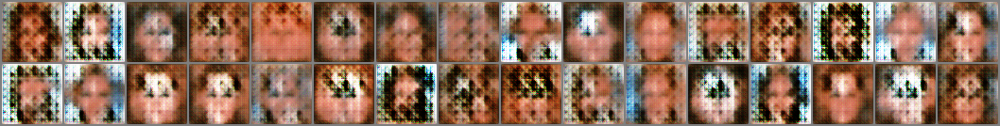

[13/50] 	Loss_D: 23288.6401	Loss_G: 34332.5788


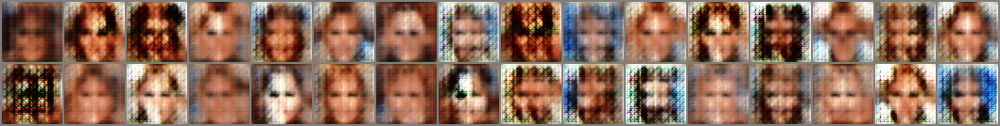

[14/50] 	Loss_D: 24167.6139	Loss_G: 24377.4421


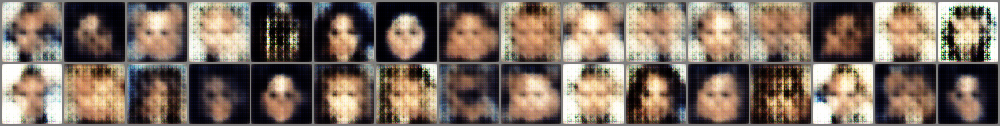

[15/50] 	Loss_D: 1517.3316	Loss_G: 7001.3607


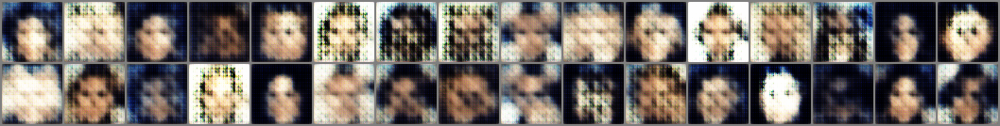

[16/50] 	Loss_D: 6280.4450	Loss_G: 15596.2809


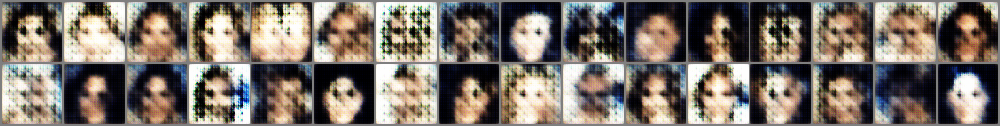

[17/50] 	Loss_D: 13114.9064	Loss_G: 22211.0885


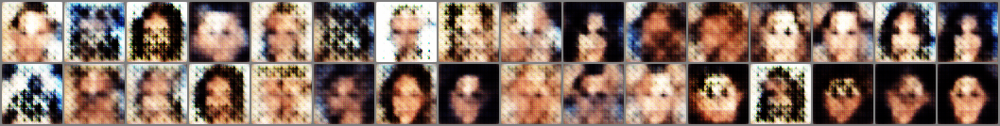

[18/50] 	Loss_D: 14665.2823	Loss_G: 28406.6921


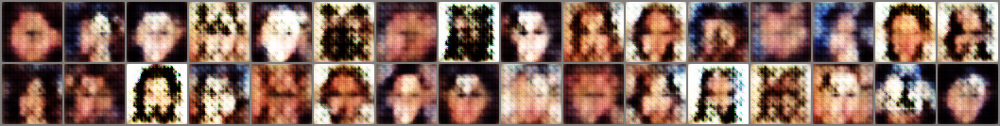

[19/50] 	Loss_D: 22909.0723	Loss_G: 34539.1400


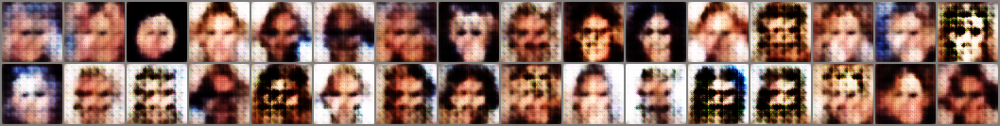

[20/50] 	Loss_D: 19666.4660	Loss_G: 32839.9896


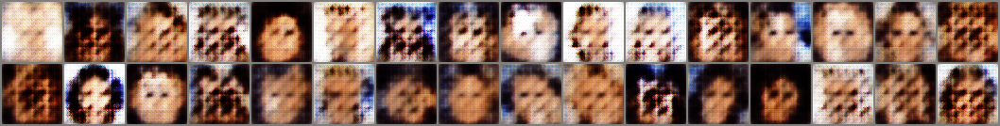

[21/50] 	Loss_D: 21488.3971	Loss_G: 20314.7920


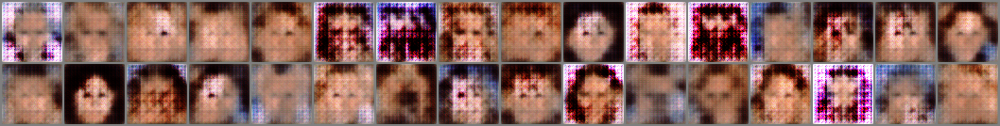

[22/50] 	Loss_D: 20274.8676	Loss_G: 33566.5592


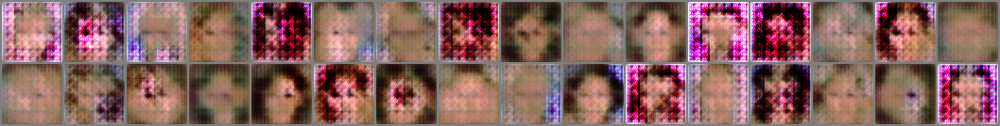

[23/50] 	Loss_D: 30896.4262	Loss_G: 42348.6641


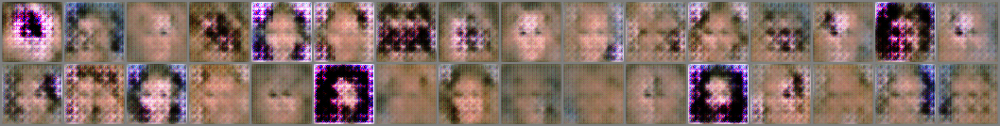

[24/50] 	Loss_D: 40197.6031	Loss_G: 46955.0286


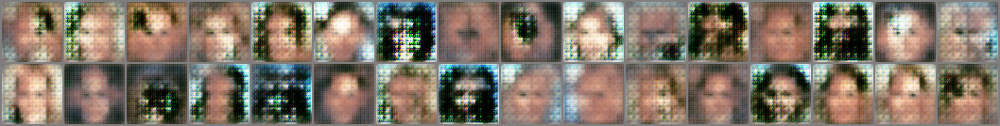

[25/50] 	Loss_D: 28344.1666	Loss_G: 42025.0189


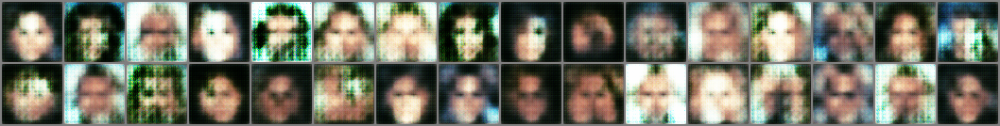

[26/50] 	Loss_D: 13331.8863	Loss_G: 28984.2051


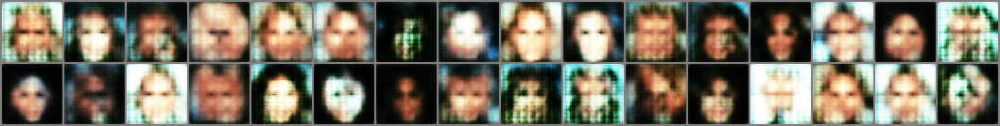

KeyboardInterrupt: 

In [17]:
# Main loop
torch.manual_seed(1)

for epoch in range(n_epochs):
    
        ############################
        ### Train discriminator (niterD iterations)
        ############################
        show(G)
        Gloss = torch.tensor(0.0, device=device)
        Dloss = torch.tensor(0.0, device=device)
        for iter in range(0, niterD):
            Dloss_cum = 0.0
            for y in train_loader:
                y = y.to(device)
                z = torch.randn(b, options.n_filters, 1, 1).to(device)
                x = G(z)
                features_x = D(x)
                features_y = D(y)
                optimD.zero_grad()
                Dloss = -mmd2(kernel, features_x, features_y) + gpw*gradient_penalty(D, kernel, x, y)
                Dloss.backward()
                optimD.step()
                Dloss_cum += -Dloss.item()
            Dloss_cum = Dloss_cum/len(train_loader)
            Dlosses.append(Dloss_cum)

                # print(-Dloss.item())
        
        
        ############################
        ### Train generator (niterG iterations)
        ############################
        for iter in range(0, niterG):
            Gloss_cum = 0.0
            for y in test_loader:
                y = y.to(device)
                z = torch.randn(b, options.n_filters, 1, 1).to(device)
                x = G(z)
                features_x = D(x)
                features_y = D(y)
                
                optimG.zero_grad()
                Gloss = mmd2(kernel, features_x, features_y) 
                Gloss.backward()
                optimG.step()
                Gloss_cum += Gloss.item()
            Gloss_cum = Gloss_cum/len(test_loader)
            Glosses.append(Gloss_cum)


        # schedulerD.step()
        # schedulerG.step()
    
        # Output training stats
        # if (epoch%loss_display ==0):
        print('[%d/%d] \tLoss_D: %.4f\tLoss_G: %.4f'
        % (epoch, n_epochs, Dloss_cum, Gloss_cum))

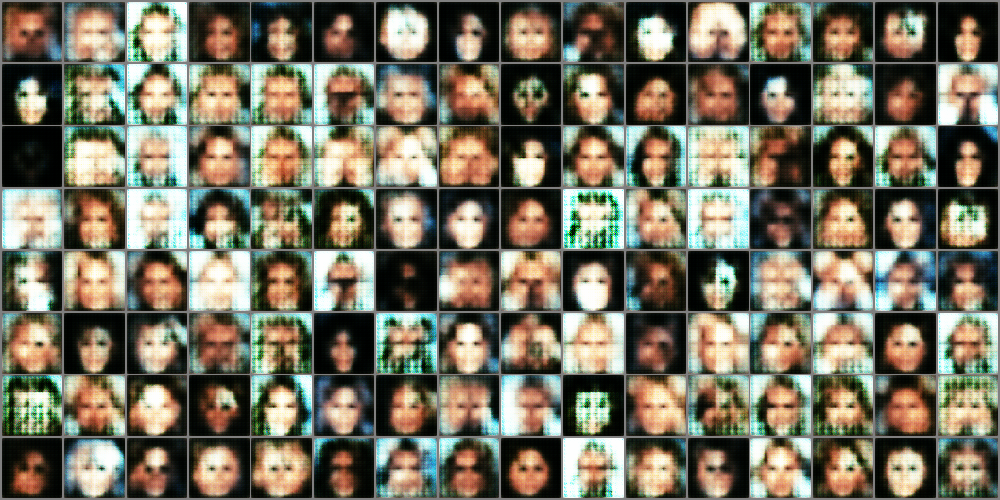

In [18]:
show(G,batch_size=128)

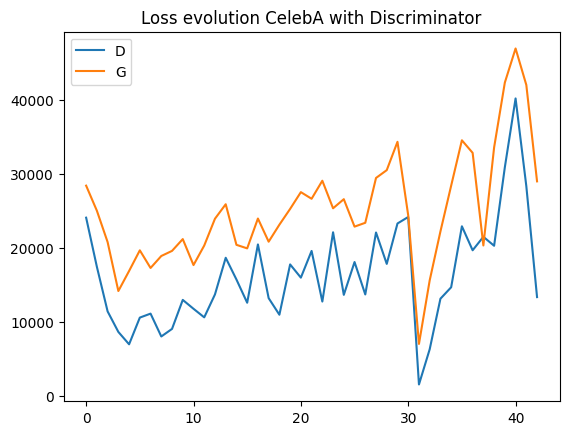

In [20]:
plt.figure(dpi=100)
plt.plot(Dlosses,label='D')
plt.plot(Glosses,label='G')
plt.title('Loss evolution CelebA with Discriminator')
plt.legend()
plt.show()